# Test to repliacate real images


In [2]:
import tifffile as tiff
from helpersGeneration import *
from helpersTracking import *

In [3]:

# Load the .tif file
image_3d = tiff.imread('real-data/70_01_7.tif')

print(image_3d.shape)  # (slices, height, width) or sometimes (height, width) if it's 2D

(1000, 170, 512)


In [4]:
play_video(image_3d[:100], figsize=(24,8), no_borders=True)

vmin: 491 vmax: 12674 mean: 1351.78


Animation size has reached 21146250 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [5]:
frame0 = image_3d[0]
test_image =  frame0[0:200,0:200]

In [6]:

%load_ext autoreload
%reload_ext autoreload
%autoreload 2

coordinates, filtered_image = detect_particles(frame0.astype(np.float32))
# Print number of detected particles
print(f"Detected {len(coordinates)} particles")

# Access first particle coordinates (y, x)
if len(coordinates) > 0:
    print(f"First particle at y={coordinates[0][0]}, x={coordinates[0][1]}")

Detected 169 particles
First particle at y=45, x=168


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Detected 20 particles
First particle at y=46, x=168


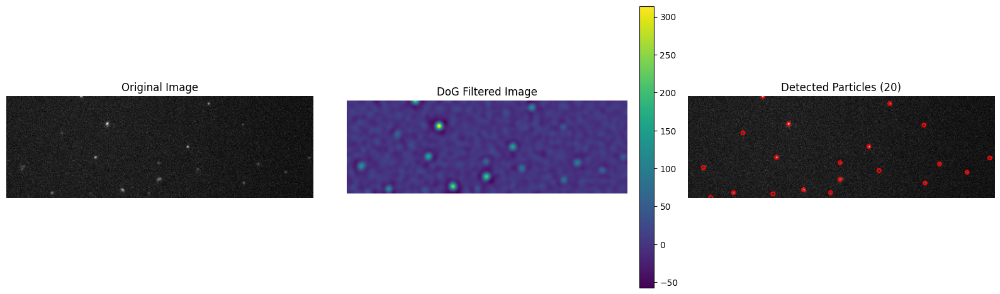

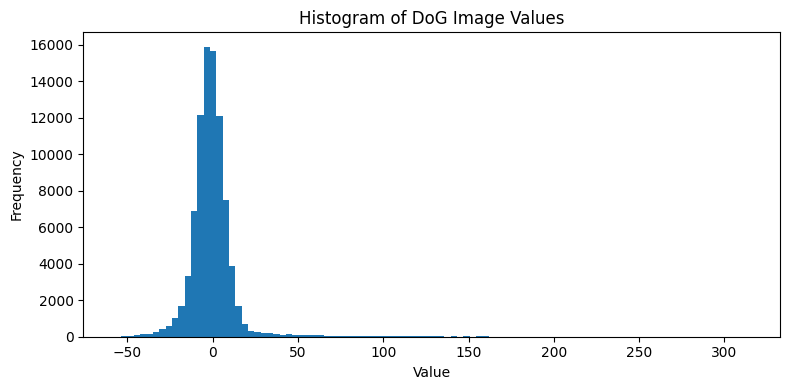

In [7]:
from helpersTracking import *
%load_ext autoreload
%reload_ext autoreload
%autoreload 2

# Detect particles
coordinates, dog_image = detect_particles(
    frame0.astype(np.float32), 
    sigma1=5.0,  # Adjust based on your particle size
    sigma2=7.0,  # Should be larger than sigma1
    min_distance=10  # Minimum separation between particles
)
# Print number of detected particles
print(f"Detected {len(coordinates)} particles")

# Access first particle coordinates (y, x)
if len(coordinates) > 0:
    print(f"First particle at y={coordinates[0][0]}, x={coordinates[0][1]}")
# Visualize results
visualize_dog_detection(frame0, dog_image, coordinates)

In [8]:
from helpersTracking import *
%load_ext autoreload
%reload_ext autoreload
%autoreload 2

# Load your image sequence (example)
image_sequence = image_3d[:20,:,:].astype(np.float32)

# Run the analysis
tracks, detections, filtered_images = analyze_microscopy_sequence(
    image_sequence,
    sigma1=5.0,                  # Adjust for your particle size
    sigma2=7.0,                  # Adjust for your particle size
    threshold_percentage=0.1,    # Adjust based on signal-to-noise ratio
    min_distance=3,              # Minimum distance between particles
    max_linking_distance=15,     # Maximum movement between frames
    min_track_length=3,          # Minimum track length to keep
    visualize=True,
    verbose=False,
    #output_prefix="experiment1"  # Optional: save results with this prefix
)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Tracking complete: 76 total tracks, 29 tracks with ≥3 frames


In [9]:
tracks_stats = {k: len(tracks[k]) for k in tracks.keys()}
print(tracks_stats)

{0: 20, 1: 5, 2: 20, 3: 20, 4: 14, 6: 9, 7: 20, 8: 20, 9: 20, 10: 20, 12: 3, 13: 20, 14: 20, 15: 20, 16: 20, 18: 14, 20: 18, 22: 6, 26: 4, 31: 3, 32: 10, 46: 4, 50: 3, 51: 9, 52: 9, 65: 3, 66: 6, 70: 3, 72: 3}


In [10]:
import numpy as np

def extract_particle_patches(image_3d, tracks, patch_size=7):
    """
    Extract square patches around each particle's position in each frame.

    Parameters:
    -----------
    image_3d : np.ndarray
        3D array of shape (num_frames, height, width).
    tracks : dict
        Dictionary where keys are track IDs and values are lists of (frame, y, x) positions.
    patch_size : int
        Size of the square patch (must be odd).

    Returns:
    --------
    patches : dict
        Dictionary where each key is a track ID and value is a list of 2D numpy arrays
        of shape (patch_size, patch_size), one per position in the track.
    """
    assert patch_size % 2 == 1, "patch_size must be an odd number"
    half = patch_size // 2
    num_frames, height, width = image_3d.shape

    patches = {}

    for track_id, positions in tracks.items():
        track_patches = []
        for frame, y, x in positions:
            
            y, x = int(round(y)), int(round(x))
            # Pad the image if the patch would go out of bounds
            padded = np.pad(image_3d[frame], pad_width=half, mode='constant')
            y_p, x_p = y + half, x + half  # shift coords due to padding
            patch = padded[y_p - half:y_p + half + 1, x_p - half:x_p + half + 1]
            track_patches.append(patch)
        patches[track_id] = np.array(track_patches)

    return patches


patch_size = 15
patches = extract_particle_patches(image_3d, tracks, patch_size=patch_size)

# Accessing one example patch
first_track_id = list(patches.keys())[0]
example_patch = patches[first_track_id][0]
print(example_patch.shape)  # (7, 7)
play_video(patches[0])

(15, 15)
vmin: 700 vmax: 11208 mean: 2047.45


In [11]:
import numpy as np
import pandas as pd
from scipy.optimize import curve_fit

def add_refined_localization_to_dataframe(df_tracks, tracks, patches, patch_size):
    """
    Add sub-pixel localization, PSF size (sigma), and max intensity per frame to DataFrame.
    """
    def symmetrical_gaussian(coords, amplitude, xo, yo, sigma, offset):
        x, y = coords
        g = offset + amplitude * np.exp(
            -(((x - xo)**2 + (y - yo)**2) / (2 * sigma**2))
        )
        return g.ravel()

    half = patch_size // 2

    x_refined_list = []
    y_refined_list = []
    sigma_list = []
    intensity_list = []

    for track_id, original_positions in tracks.items():
        track_patches = patches[track_id]
        for i, (frame, y_int, x_int) in enumerate(original_positions):
            patch = track_patches[i]
            x = np.arange(patch.shape[1])
            y = np.arange(patch.shape[0])
            x, y = np.meshgrid(x, y)

            initial_guess = (patch.max(), half, half, 1.0, patch.min())

            try:
                popt, _ = curve_fit(symmetrical_gaussian, (x, y), patch.ravel(), p0=initial_guess)
                _, x0, y0, sigma, _ = popt
                refined_x = x_int - half + x0
                refined_y = y_int - half + y0
            except RuntimeError:
                print(f"particle {track_id} could not be located on frame {frame}")
                refined_x = x_int
                refined_y = y_int
                sigma = 10

            key = (track_id, frame)
            x_refined_list.append((key, refined_x))
            y_refined_list.append((key, refined_y))
            sigma_list.append((key, sigma))
            intensity_list.append((key, patch.max()))

    df_tracks['x_refined'] = pd.Series(dict(x_refined_list))
    df_tracks['y_refined'] = pd.Series(dict(y_refined_list))
    df_tracks['psf_size'] = pd.Series(dict(sigma_list))
    df_tracks['max_intensity'] = pd.Series(dict(intensity_list))

    return df_tracks


def compute_displacement(df_tracks):
    """
    Compute displacement, mean displacement, mean PSF size, and max intensity over track.
    """
    displacements = []
    mean_displacements = {}
    mean_psf_sizes = {}
    max_intensities = {}

    df_tracks_reset = df_tracks.reset_index()

    for track_id, group in df_tracks_reset.groupby('track_id'):
        group = group.sort_values('frame')
        track_displacements = []

        for i in range(1, len(group)):
            x1, y1 = group.iloc[i-1][['x_refined', 'y_refined']]
            x2, y2 = group.iloc[i][['x_refined', 'y_refined']]
            displacement = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            track_displacements.append(displacement)

        track_displacements.insert(0, 0)
        df_tracks_reset.loc[group.index, 'displacement'] = track_displacements

        mean_displacements[track_id] = np.mean(track_displacements)
        mean_psf_sizes[track_id] = group['psf_size'].mean()
        max_intensities[track_id] = group['max_intensity'].max()

    df_tracks_reset.set_index(['track_id', 'frame'], inplace=True)
    df_tracks_reset['mean_displacement'] = df_tracks_reset.index.get_level_values('track_id').map(mean_displacements)
    df_tracks_reset['mean_psf_size'] = df_tracks_reset.index.get_level_values('track_id').map(mean_psf_sizes)
    df_tracks_reset['max_intensity_over_track'] = df_tracks_reset.index.get_level_values('track_id').map(max_intensities)

    return df_tracks_reset





def tracks_to_dataframe(tracks, patches, patch_size):
    """
    Convert tracks dictionary into a pandas DataFrame indexed by (track_id, frame)
    and containing x and y positions.

    Parameters:
    -----------
    tracks : dict
        Dictionary where keys are track IDs and values are lists of (frame, y, x) positions.

    Returns:
    --------
    df : pandas.DataFrame
        DataFrame indexed by (track_id, frame) with columns 'x' and 'y'.
    """
    data = []
    for track_id, positions in tracks.items():
        nbr_frames = len(positions)
        for frame, y, x in positions:
            data.append((track_id, frame,nbr_frames, x, y))
    
    df = pd.DataFrame(data, columns=['track_id', 'frame', 'nbr_frames','x', 'y'])
    df.set_index(['track_id', 'frame'], inplace=True)
    df.sort_index(inplace=True)  # Optional: to have it ordered by track and frame

    df = add_refined_localization_to_dataframe(df, tracks, patches, patch_size=patch_size)
    df = compute_displacement(df)

    return df


patches = extract_particle_patches(image_3d, tracks, patch_size=patch_size)


df_tracks = tracks_to_dataframe(tracks, patches, patch_size)

df_tracks.head(22)


particle 2 could not be located on frame 19


nbr_frames    x    y   x_refined   y_refined  psf_size  \
track_id frame                                                           
0        0              20  168   46  167.965831   45.593653  1.763921   
         1              20  168   49  167.491937   48.290227  1.438999   
         2              20  165   47  165.241028   46.992144  1.865024   
         3              20  171   48  171.242887   48.258902  2.164407   
         4              20  175   50  175.468579   49.832370  2.125498   
         5              20  173   53  173.356575   52.601250  1.580760   
         6              20  173   56  173.748108   54.809303  1.236924   
         7              20  174   56  173.943929   55.460296  1.064971   
         8              20  174   56  173.952118   55.948592  1.281982   
         9              20  173   56  173.826849   55.935574  1.273288   
         10             20  174   55  174.244287   55.816285  1.132745   
         11             20  174   56  174.373790   56.103270  1.201747   
         12             20  175   54  175.108856   53.567693  1.625821   
         13             20  174   54  174.543781   54.232590  1.633296   
         14             20  174   57  173.773984   57.323477  1.541446   
         15             20  174   53  174.146847   53.138751  1.503775   
         16             20  171   55  170.654405   54.536597  1.905682   
         17             20  171   53  171.455600   52.399130  2.399239   
         18             20  174   52  174.100850   51.766881  2.093641   
         19             20  180   48  180.210995   48.289516  1.583251   
1        0               5  193  156  193.525343  156.226138  1.842701   
         1               5  189  159  188.751659  159.483178  2.265507   

                max_intensity  displacement  mean_displacement  mean_psf_size  \
track_id frame                                                                  
0        0               7746      0.000000           2.522065       1.620821   
         1               9864      2.737898           2.522065       1.620821   
         2               6454      2.598386           2.522065       1.620821   
         3               7019      6.134084           2.522065       1.620821   
         4               5683      4.509133           2.522065       1.620821   
         5               9184      3.482422           2.522065       1.620821   
         6               5491      2.242497           2.522065       1.620821   
         7               5002      0.679807           2.522065       1.620821   
         8               7476      0.488364           2.522065       1.620821   
         9              10952      0.125943           2.522065       1.620821   
         10              4952      0.434147           2.522065       1.620821   
         11              6425      0.314852           2.522065       1.620821   
         12              9553      2.639976           2.522065       1.620821   
         13             10531      0.872581           2.522065       1.620821   
         14             11208      3.185305           2.522065       1.620821   
         15             11027      4.201304           2.522065       1.620821   
         16              9210      3.761797           2.522065       1.620821   
         17              6942      2.282691           2.522065       1.620821   
         18              8234      2.719759           2.522065       1.620821   
         19             10452      7.030358           2.522065       1.620821   
1        0               6553      0.000000           3.908871       2.367479   
         1               4349      5.778960           3.908871       2.367479   

                max_intensity_over_track  
track_id frame                            
0        0                         11208  
         1                         11208  
         2                         11208  
         3                         11208  
         4                         1

In [12]:
# Sort the DataFrame by 'mean_displacement'
sorted_tracks = df_tracks.sort_values(by='mean_displacement')
# Drop duplicates based on the first level of the MultiIndex (track_id)
sorted_unique_tracks = sorted_tracks.reset_index().drop_duplicates(subset='track_id').set_index(['track_id', 'frame'])

sorted_unique_tracks.head(30)

,,nbr_frames,x,y,x_refined,y_refined,psf_size,max_intensity,displacement,mean_displacement,mean_psf_size,max_intensity_over_track
track_id,frame,,,,,,,,,,,
26,6,4,254,112,253.594839,112.188609,1.118674,5102,0.157777,0.107783,1.320342,5102
70,19,3,238,162,237.677885,161.246390,1.140751,3243,0.322660,0.200068,1.091208,4505
65,15,3,139,161,139.864628,161.992487,1.258051,5014,0.131819,0.243220,1.476595,5014
72,19,3,199,159,198.574553,159.809213,1.273668,2638,0.459428,0.302206,1.122070,3913
52,10,9,324,125,324.061435,124.309972,1.096285,3819,0.000000,0.307359,1.087790,5891
46,8,4,455,21,455.409878,21.300278,1.506131,3044,0.000000,0.313635,1.029012,3325
50,9,3,140,162,139.852042,161.510731,0.615235,3104,0.000000,0.339436,0.960605,3531
16,14,20,394,47,394.190116,46.848736,1.212648,3683,0.260744,0.359845,1.269262,3923
8,2,20,76,162,76.190631,161.400386,1.389996,4524,0.344697,0.378223,1.343141,7221


In [13]:
play_video(patches[8])


vmin: 665 vmax: 7221 mean: 1624.20


In [14]:
df_tracks.loc[20]

,nbr_frames,x,y,x_refined,y_refined,psf_size,max_intensity,displacement,mean_displacement,mean_psf_size,max_intensity_over_track
frame,,,,,,,,,,,
2,18,304,86,303.881796,85.613421,1.450016,6200,0.000000,0.737459,1.336639,7004
3,18,305,86,304.701173,85.715356,1.400531,5599,0.825693,0.737459,1.336639,7004
4,18,305,86,304.983889,86.183952,1.405929,5693,0.547275,0.737459,1.336639,7004
5,18,305,86,305.239930,86.123947,1.220861,6499,0.262979,0.737459,1.336639,7004
6,18,306,85,305.773181,85.461993,1.442962,5676,0.850023,0.737459,1.336639,7004
7,18,307,85,306.474589,85.236080,1.233543,7004,0.736893,0.737459,1.336639,7004
8,18,307,86,306.796546,85.599515,1.460752,5339,0.485531,0.737459,1.336639,7004
9,18,307,87,306.373340,87.074035,1.320730,6328,1.534052,0.737459,1.336639,7004
10,18,308,87,307.868971,86.555758,1.290243,6523,1.582885,0.737459,1.336639,7004


## Trying to create images similar to this: 


In [18]:
nPosPerFrame = 10
D = 50000
dt = 0.1
max_intensity = 5000
background_mean = 1250
background_std = 319
vmin, vmax = 0, 7200


traj = brownian_motion(1,16,nPosPerFrame,D,dt,True)

image_dict = {
    "particle_intensity": [
        max_intensity - background_mean,
        500,
    ],  # Mean and standard deviation of the particle intensity
    "NA": 1.46,  # Numerical aperture
    "wavelength": 500e-9,  # Wavelength
    "psf_division_factor": 1.5,  
    "resolution": 100e-9,  # Camera resolution or effective resolution, aka pixelsize
    "output_size": patch_size,
    "upsampling_factor": 5,
    "background_intensity": [
        background_mean,
        background_std,
    ],  # Standard deviation of background intensity within a video
    "poisson_noise": 100,
    "trajectory_unit" : 1
}
nFrames = 100

gen_vid, poisson_vid, poisson2 = trajectories_to_videoTest(traj,nPosPerFrame,center=False,image_props=image_dict)

play_video(gen_vid[0], vmin=vmin, vmax=vmax)
play_video(patches[8], vmin=vmin, vmax=vmax)


vmin: 0 vmax: 7200 mean: 1355.04


vmin: 0 vmax: 7200 mean: 1624.20


In [16]:
def trajectories_to_videoTest(
    trajectories,
    nPosPerFrame,
    center = False,
    image_props={},
    use_multiprocessing = False,
):
    
    N,T,_ = trajectories.shape

# Invert the y axis, for video creation purposes where y-axis is inverted
    trajectories[:, :, 1] *= -1


    if(T % nPosPerFrame != 0):
        raise Exception("T is not divisble by posPerFrame")

    nFrames = T // nPosPerFrame

    _image_dict = {
        "particle_intensity": [
            500,
            20,
        ],  # Mean and standard deviation of the particle intensity
        "NA": 1.46,  # Numerical aperture
        "wavelength": 500e-9,  # Wavelength
        "psf_division_factor": 1, 
        "resolution": 100e-9,  # Camera resolution or effective resolution, aka pixelsize
        "output_size": 32,
        "upsampling_factor": 5,
        "background_intensity": [
            100,
            10,
        ],  # Standard deviation of background intensity within a video
        "poisson_noise": 1,
        "trajectory_unit" : 100
    }

    # Update the dictionaries with the user-defined values
    _image_dict.update(image_props)
    resolution =_image_dict["resolution"]
    traj_unit = _image_dict["trajectory_unit"]
    
    if(traj_unit !=-1 ):
        trajectories = trajectories * traj_unit* 1e-9 / resolution

    output_size = _image_dict["output_size"]
    upsampling_factor = _image_dict["upsampling_factor"]
    psf_div_factor = _image_dict["psf_division_factor"]
    
    # Psf is computed as wavelenght/2NA according to:
    #https://www.sciencedirect.com/science/article/pii/S0005272819301380?via%3Dihub
    fwhm_psf = _image_dict["wavelength"] / 2 * _image_dict["NA"] / psf_div_factor

    
    gaussian_sigma = upsampling_factor/ resolution * fwhm_psf/2.355
    poisson_noise = _image_dict["poisson_noise"]
    
    out_videos = np.zeros((N,nFrames,output_size,output_size),np.float32)
    out_videos_Poisson = np.zeros((N,nFrames,output_size,output_size),np.float32)
    out_videos_Poisson2 = np.zeros((N,nFrames,output_size,output_size),np.float32)

    particle_mean, particle_std = _image_dict["particle_intensity"][0],_image_dict["particle_intensity"][1]
    background_mean, background_std = _image_dict["background_intensity"][0],_image_dict["background_intensity"][1]
    
    for n in range(N):
        trajectory_to_videoTest(out_videos[n,:],out_videos_Poisson[n,:], out_videos_Poisson2[n,:],trajectories[n,:],nFrames,output_size,upsampling_factor,nPosPerFrame,
                                                gaussian_sigma,particle_mean,particle_std,background_mean,background_std, poisson_noise,center)
        
    return out_videos, out_videos_Poisson, out_videos_Poisson2


def trajectory_to_videoTest(out_video,out_videoPoisson, out_videoPoisson2,trajectory,nFrames, output_size, upsampling_factor, nPosPerFrame,gaussian_sigma,particle_mean,particle_std,background_mean,background_std, poisson_noise, center):
    """Helper function of function above, all arguments documented above"""
    for f in range(nFrames):
        frame_hr = np.zeros(( output_size*upsampling_factor, output_size*upsampling_factor),np.float32)
        frame_lr = np.zeros((output_size, output_size),np.float32)

        start = f*nPosPerFrame
        end = (f+1)*nPosPerFrame
        trajectory_segment = (trajectory[start:end,:] - np.mean(trajectory[start:end,:],axis=0) if center else trajectory[start:end,:]) 
        xtraj = trajectory_segment[:,0]  * upsampling_factor
        ytraj = trajectory_segment[:,1] * upsampling_factor

        

        # Generate frame, convolution, resampling, noise
        for p in range(nPosPerFrame):
            if(particle_mean >0.0001 and particle_std > 0.0001):
                spot_intensity = np.random.normal(particle_mean/nPosPerFrame,particle_std/nPosPerFrame)
                frame_spot = gaussian_2d(xtraj[p], ytraj[p], gaussian_sigma, output_size*upsampling_factor, spot_intensity)

                # gaussian_2d maximum is not always the wanted one because of some misplaced pixels. 
                # We can force the peak of the gaussian to have the right intensity
                spot_max = np.max(frame_spot)
                if(spot_max < 0.00001):
                    print("Particle Left the image")
                frame_hr += spot_intensity/spot_max * frame_spot
        
        frame_lr = block_reduce(frame_hr, block_size=upsampling_factor, func=np.mean)
        # Add Gaussian noise to background intensity across the image
        frame_lr += np.clip(np.random.normal(background_mean, background_std, frame_lr.shape), 
                                    0, background_mean + 3 * background_std)

        frame_lr_poisson = np.random.poisson(frame_lr)
        frame_lr_poisson2 = frame_lr * np.random.poisson(poisson_noise, size=(frame_lr.shape)) / poisson_noise

        out_video[f,:] = frame_lr
        out_videoPoisson[f,:] = frame_lr_poisson
        out_videoPoisson2[f,:] = frame_lr_poisson2

    return


(22500,) (22500,)


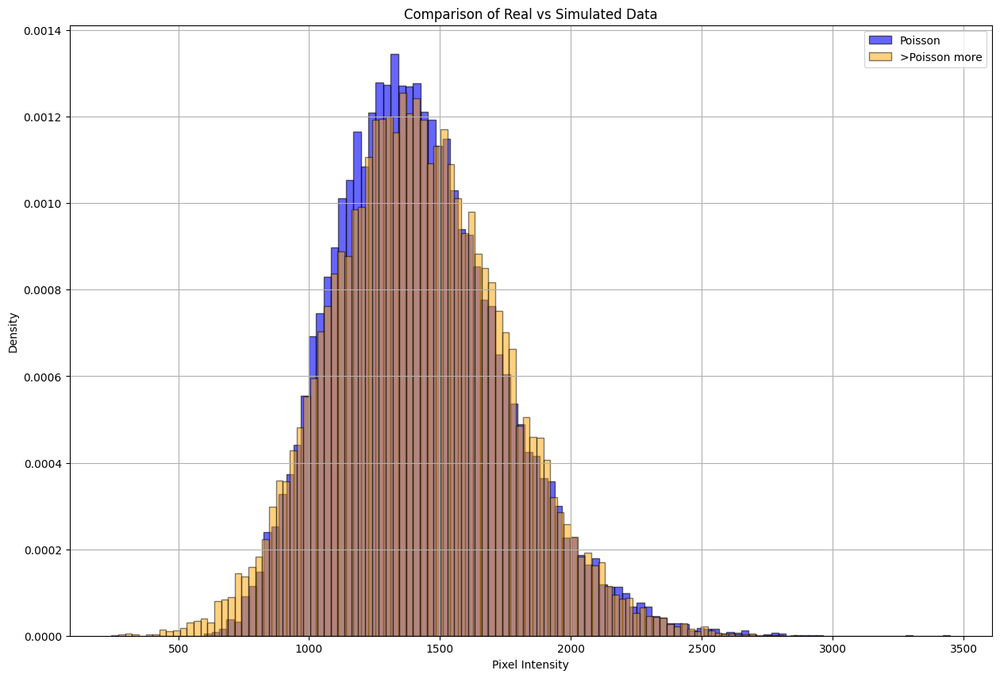

1419.4007111111111 318.6566173581854
1418.2615 331.48135
1468.2191 297.25745


In [37]:
import matplotlib.pyplot as plt
import numpy as np

# Let's say:
# real_data = your flattened real noisy patch
# simulated_data = your flattened simulated noisy patch
background_mean = 1419
background_std = 300

image_dict = {
    "particle_intensity": [
        0,
        0,
    ],  # Mean and standard deviation of the particle intensity
    "NA": 1.46,  # Numerical aperture
    "wavelength": 500e-9,  # Wavelength
    "psf_division_factor": 1.5,  
    "resolution": 100e-9,  # Camera resolution or effective resolution, aka pixelsize
    "output_size": patch_size,
    "upsampling_factor": 5,
    "background_intensity": [
        background_mean,
        background_std,
    ],  # Standard deviation of background intensity within a video
    "poisson_noise": 100,
    "trajectory_unit" : 1
}
nFrames = 100

n_part = 100

traj = brownian_motion(n_part,1,nPosPerFrame,D,dt,True)

gen_vid, poisson_vid, poisson_vid2 = trajectories_to_videoTest(traj,nPosPerFrame,center=False,image_props=image_dict)
# Example: (you should already have them)

simulated_data_poisson = image_3d[0:n_part,0:patch_size,0:patch_size].flatten()
#simulated_data_poisson = gen_vid.flatten()

simulated_data = poisson_vid2.flatten()
simulated_data_no_noise = gen_vid[0].flatten()
print(simulated_data_poisson.shape, simulated_data.shape)
# Create figure
plt.figure(figsize=(15, 10))
x = 0
# Plot real data histogram
plt.hist(simulated_data_poisson[simulated_data_poisson > x], bins=100, density=True, alpha=0.6, color='blue', label='Poisson', edgecolor='black')
#plt.hist(simulated_data_no_noise[simulated_data_no_noise > x], bins=100, density=True, alpha=0.6, color='green', label='Poisson', edgecolor='black')

# Plot simulated data histogram
plt.hist(simulated_data[simulated_data > x], bins=100, density=True, alpha=0.5, color='orange', label='>Poisson more', edgecolor='black')

# Labels and title
plt.xlabel('Pixel Intensity')
plt.ylabel('Density')
plt.title('Comparison of Real vs Simulated Data')
plt.legend()
plt.grid(True)
plt.show()


print(np.mean((simulated_data_poisson[simulated_data_poisson > x]-x)), np.sqrt(np.var((simulated_data_poisson[simulated_data_poisson > x]-x))))
print(np.mean((simulated_data[simulated_data > x])-x), np.sqrt(np.var((simulated_data[simulated_data > x]-x))))
print(np.mean((simulated_data_no_noise[simulated_data_no_noise > x])-x), np.sqrt(np.var((simulated_data_no_noise[simulated_data_no_noise > x]-x))))



In [ ]:
print(simulated_data)

[   0.     1297.7878    0.     ... 1570.1167 3499.6384 1324.8997]
